# Análise das amostras de magnitudes de galáxias 

## 1 - Setup 

importando as bibliotecas que serão utilizadas

In [241]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

definindo algumas variáveis que serão úteis e realizando a leitura do arquivo .train

In [242]:
headers=[
    "u_auto", "u_auto_err", "u_det", "u_det_err",
    "g_auto", "g_auto_err", "g_det", "g_det_err", 
    "r_auto", "r_auto_err", "r_det", "r_det_err", 
    "i_auto", "i_auto_err", "i_det", "i_det_err", 
    "z_auto", "z_auto_err", "z_det", "z_det_err", 
    "Y_auto", "Y_auto_err", "Y_det", "Y_det_err", 
    "z", "ra", "dec", "z_flags", "field_id", "number"
]

banda_cor = {
    "u": "m",
    "g": "g",
    "r": "b",
    "i": "r",
    "z": "y",
    "Y": "k",
}

data_frame = pd.read_csv("des_sv_main_standard.train", delimiter=" ", names=headers)

## 2 - Analisando a amostra por valor de magnitude e erro (no cálculo ou captura da amostra)

### 2.1 - Visão Geral

Primeiro, olhando o conteúdo separado, pode-se notar que dentro da nossa amostra total, para cada banda, existem alguns pontos com valores de erro e magnitude bem altos.

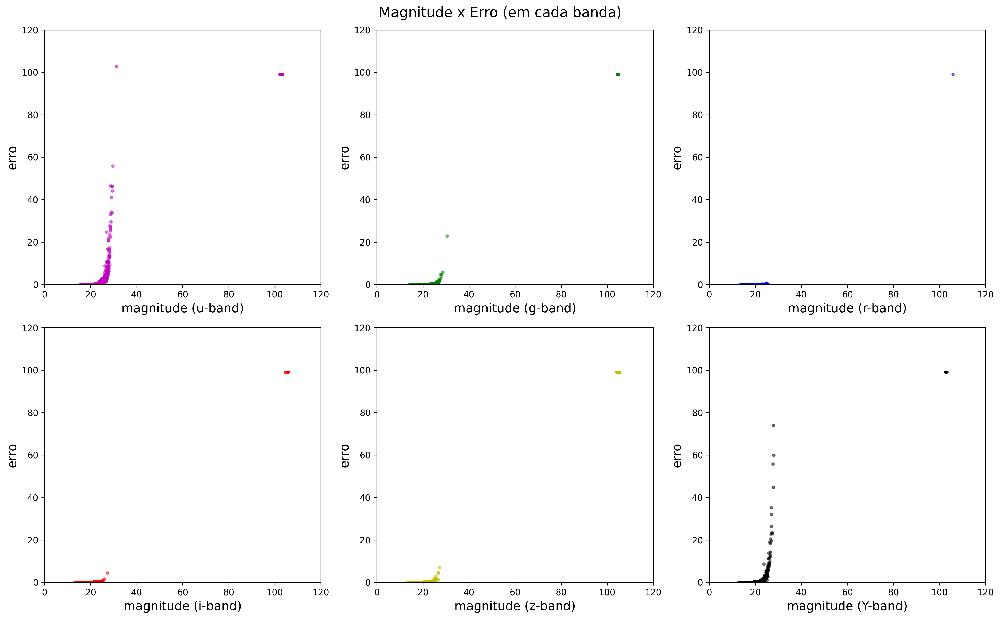

In [98]:
plt.figure(figsize=[16,10], dpi=300)
plt.suptitle("Magnitude x Erro (em cada banda)", fontsize=16)

pos_grafico = 1

for key, value in banda_cor.items():
    plt.subplot(2,3,pos_grafico)
    plt.plot(data_frame[f"{key}_auto"], data_frame[f"{key}_auto_err"], f"{value}.", alpha=0.5)
    plt.xlabel(f"magnitude ({key}-band)", fontsize=14)
    plt.ylabel("erro", fontsize=14)
    plt.xlim(0, 120)
    plt.ylim(0, 120)
    plt.tight_layout()

    pos_grafico = pos_grafico + 1

Podemos ver, com base nos gráficos, que, as bandas com maior erro na captura da magnitude são as bandas mais extremas u e y. Também pode-se observar que para todas as bandas existem magnitudes que extrapolam, ou estão muito próximas ao valor de 100. Olhando com mais cautela, vemos que não necessáriamente são os mesmos pontos. O que pode configurar objetos com características diferentes, por exemplo, comparando evolução em questão de idade do objeto e emissão de comprimento de onda maior em certa banda. 

obs: Aqui limitamos em 5 só para conseguir ver na tabela alguns objetos com magnitude maior que 100

In [140]:
data_frame.query("u_auto > 100").head(5)

,u_auto,u_auto_err,u_det,u_det_err,g_auto,g_auto_err,g_det,g_det_err,r_auto,r_auto_err,...,Y_auto,Y_auto_err,Y_det,Y_det_err,z,ra,dec,z_flags,field_id,number
19,102.300003,99.0,23.792501,1.094959,22.113060,0.067981,21.612234,0.048982,20.704815,0.034818,...,19.116783,0.044421,18.071934,0.019875,0.624862,208.736428,5.069336,3.0,17.0,17382.0
22,102.300003,99.0,24.452652,0.519227,22.849508,0.075569,22.795902,0.047686,21.147751,0.024607,...,19.359325,0.026665,19.119003,0.014577,0.686781,209.247110,5.088807,3.0,17.0,18680.0
49,102.300003,99.0,24.263866,0.954380,22.556496,0.085188,22.072447,0.043945,20.749512,0.025995,...,19.287985,0.038688,18.824326,0.020035,0.523108,208.883578,5.365280,3.0,17.0,35941.0
62,102.300003,99.0,102.300003,99.000000,22.626915,0.072182,22.408995,0.041329,20.895748,0.021281,...,19.345421,0.029546,19.046089,0.015663,0.639022,209.337538,5.472947,3.0,17.0,41285.0
127,102.300003,99.0,23.667313,0.389033,22.431358,0.061784,22.069544,0.031081,20.612705,0.018219,...,19.254866,0.029120,18.830379,0.013560,0.543911,210.482173,5.051269,3.0,17.0,71019.0


In [141]:
data_frame.query("Y_auto > 100").head(5)

,u_auto,u_auto_err,u_det,u_det_err,g_auto,g_auto_err,g_det,g_det_err,r_auto,r_auto_err,...,Y_auto,Y_auto_err,Y_det,Y_det_err,z,ra,dec,z_flags,field_id,number
246,102.300003,99.000000,13.832774,0.194720,17.140846,0.001966,17.131985,0.001418,16.300085,0.001376,...,103.180000,99.0,13.166514,0.110345,0.119883,208.719860,4.389913,3.0,17.0,142796.0
407,23.980352,0.253371,24.079817,0.278963,23.629768,0.069643,23.580387,0.058809,23.381126,0.056846,...,102.739998,99.0,102.750000,99.000000,0.864000,36.362529,-4.581767,3.0,0.0,974.0
408,23.797377,0.390823,23.330927,0.247650,23.566006,0.123223,23.029400,0.070499,22.914864,0.069703,...,102.739998,99.0,24.188515,3.052163,0.446000,36.306316,-4.579274,3.0,0.0,1267.0
411,103.150002,99.000000,103.160004,99.000000,24.145306,0.247125,22.597492,0.267177,22.035503,0.043067,...,102.739998,99.0,102.750000,99.000000,0.666000,36.288581,-4.575983,4.0,0.0,1650.0
414,24.597412,0.707796,24.317989,0.467922,24.679539,0.250967,24.415726,0.152045,23.940544,0.130340,...,102.739998,99.0,102.750000,99.000000,0.702000,36.441022,-4.572933,3.0,0.0,1976.0


### 2.2 - Visão específica 

#### Olhando os pontos específicos de perto
Se quisermos dar uma olhada mais de perto no núcleo da amostra, limitando o eixo x e y, podemos perceber que novamente, conforme se aproxima da banda r e i tem-se um menor erro.

In [57]:
def monta_grafico_plot(pos_grafico, key, value, x_min_limit, x_max_limit, y_min_limit=0, y_max_limit=100):
    plt.subplot(2,3,pos_grafico)
    plt.plot(data_frame[f"{key}_auto"], data_frame[f"{key}_auto_err"], f"{value}.", alpha=0.5)
    plt.xlabel(f"magnitude ({key}-band)", fontsize=14)
    plt.ylabel("erro", fontsize=14)
    plt.xlim(x_min_limit, x_max_limit)
    plt.ylim(y_min_limit, y_max_limit)
    plt.tight_layout()

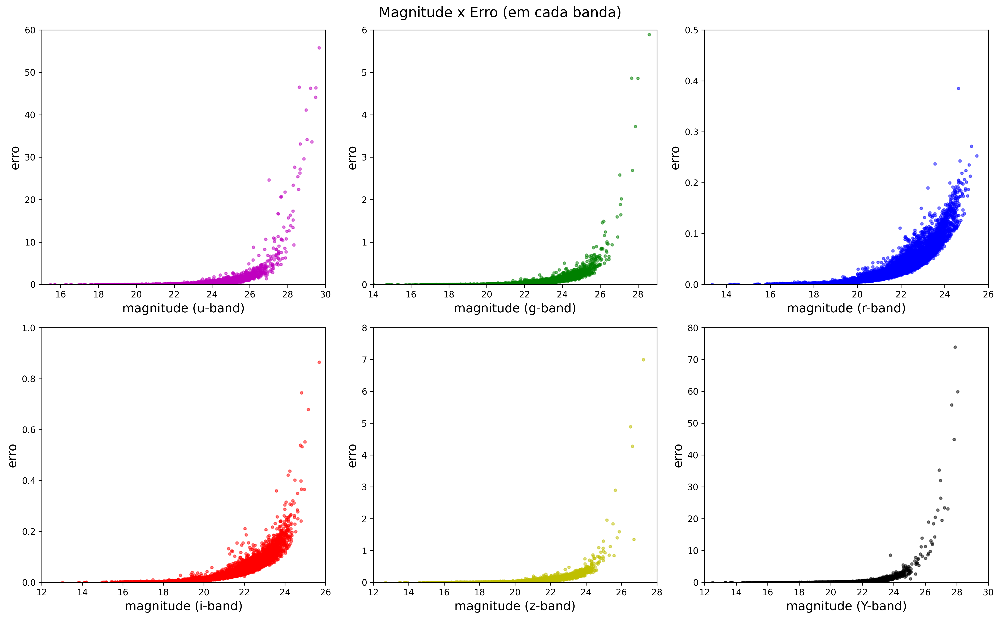

In [97]:
plt.figure(figsize=[16,10], dpi=300)
plt.suptitle("Magnitude x Erro (em cada banda)", fontsize=16)

monta_grafico_plot(1, "u", "m", 15, 30, y_max_limit=60)
monta_grafico_plot(2, "g", "g", 14, 29, y_max_limit=6)
monta_grafico_plot(3, "r", "b", 13, 26, y_max_limit=0.5)
monta_grafico_plot(4, "i", "r", 12, 26, y_max_limit=1)
monta_grafico_plot(5, "z", "y", 12, 28, y_max_limit=8)
monta_grafico_plot(6, "Y", "k", 12, 30, y_max_limit=80)

Como maior parte dos objetos, indiferente da banda, fica entre a magnitude 20 até 25, 26. Vale a pena limitar ainda mais, tanto a magnitude quanto o erro para ver melhor a disperção dos pontos nessa faixa mais ascendente.

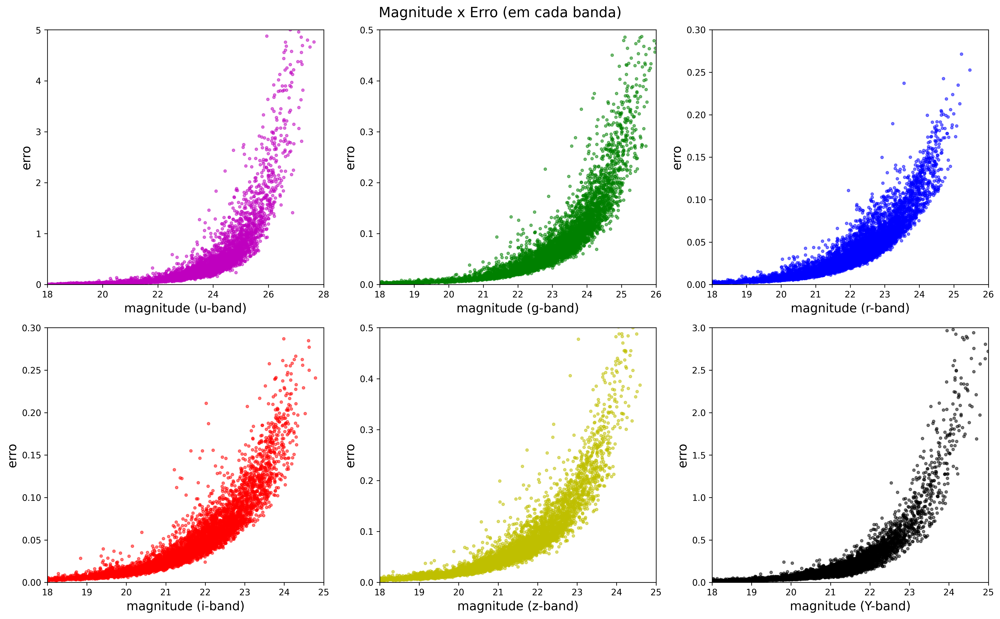

In [96]:
plt.figure(figsize=[16,10], dpi=300)
plt.suptitle("Magnitude x Erro (em cada banda)", fontsize=16)

monta_grafico_plot(1, "u", "m", 18, 28, y_max_limit=5)
monta_grafico_plot(2, "g", "g", 18, 26, y_max_limit=0.5)
monta_grafico_plot(3, "r", "b", 18, 26, y_max_limit=0.3)
monta_grafico_plot(4, "i", "r", 18, 25, y_max_limit=0.3)
monta_grafico_plot(5, "z", "y", 18, 25, y_max_limit=0.5)
monta_grafico_plot(6, "Y", "k", 18, 25, y_max_limit=3)

### 2.3 - Comparativo com mais de uma banda

Para comparação, se adicionado em um único gráfico percebemos que no geral, a banda u e a banda Y recebem maior destaque por possuirem os maiores erros.

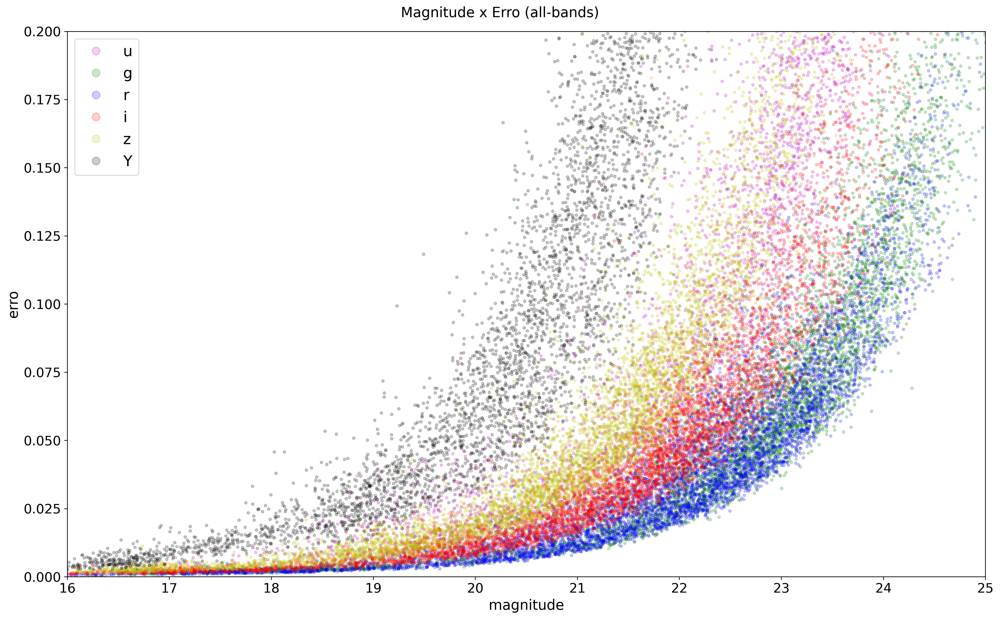

In [135]:
plt.figure(figsize=[16,10], dpi=300)
plt.suptitle("Magnitude x Erro (all-bands)", fontsize=16)

for key, value in banda_cor.items():
    plt.plot(data_frame[f"{key}_auto"], data_frame[f"{key}_auto_err"], f"{value}.", alpha=0.2, label=key)

plt.xlabel(f"magnitude", fontsize=16)
plt.ylabel("erro", fontsize=16)
plt.xticks(fontsize=15)
plt.yticks(fontsize=15)
plt.xlim(16, 25)
plt.ylim(0, 0.2)
plt.legend(loc="upper left", fontsize="xx-large", markerscale=3)
plt.tight_layout()

Pode ser interessante também, plotar as bandas com menor erro separadamente. Confirmando a proximidade das bandas r e i, por possuirem os menores erros de captura.

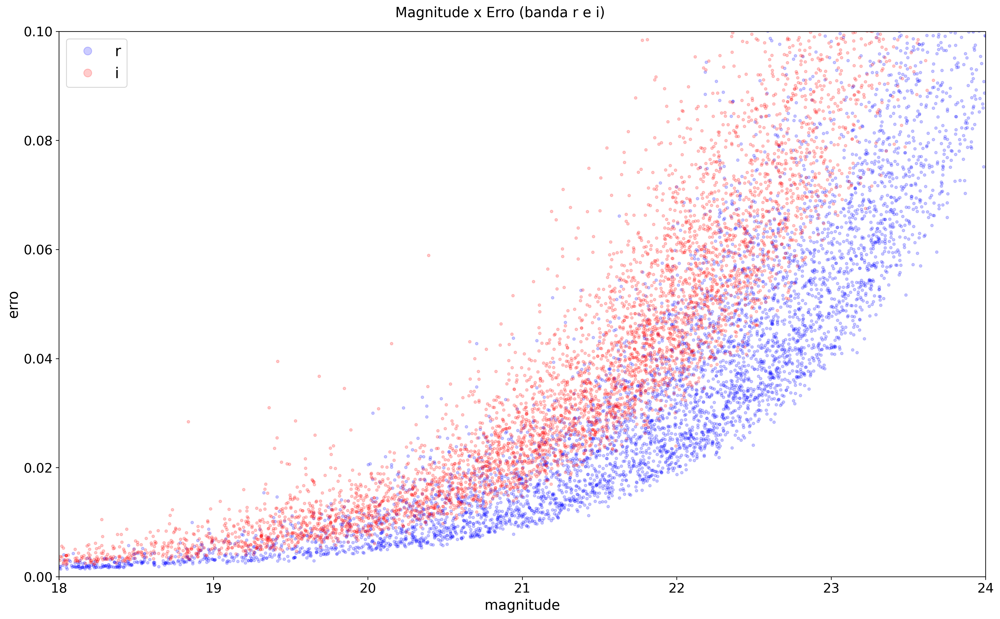

In [136]:
plt.figure(figsize=[16,10], dpi=300)
plt.suptitle("Magnitude x Erro (banda r e i)", fontsize=16)

plt.plot(data_frame["r_auto"], data_frame["r_auto_err"], f"b.", alpha=0.2, label="r")
plt.plot(data_frame["i_auto"], data_frame["i_auto_err"], f"r.", alpha=0.2, label="i")

plt.xlabel(f"magnitude", fontsize=16)
plt.ylabel("erro", fontsize=16)
plt.xticks(fontsize=15)
plt.yticks(fontsize=15)
plt.xlim(18, 24)
plt.ylim(0, 0.1)
plt.legend(loc="upper left", fontsize="xx-large", markerscale=3)
plt.tight_layout()

## 3 - Analisando amostra por quantidade

### 3.1 Visão geral

Construindo um gráfico para cada banda, percebemos que a maioria dos pontos fica ali na magnitude x e y e novamente vemos o nosso ponto com valor alto aparecendo acima da magnitude 100.

In [163]:
def monta_grafico_hist(pos, key, value, x_min = 0, x_max = 120, y_min = 0, y_max = 500):
    plt.subplot(2,3,pos)
    plt.hist(data_frame[f"{key}_auto"], bins="fd", color=value)
    plt.xlabel(f"magnitude ({key}_band)", fontsize=16)
    plt.ylabel("qtd", fontsize=16)
    plt.xticks(fontsize=15)
    plt.yticks(fontsize=15)
    plt.xlim(x_min, x_max)
    plt.ylim(y_min, y_max)
    plt.tight_layout()

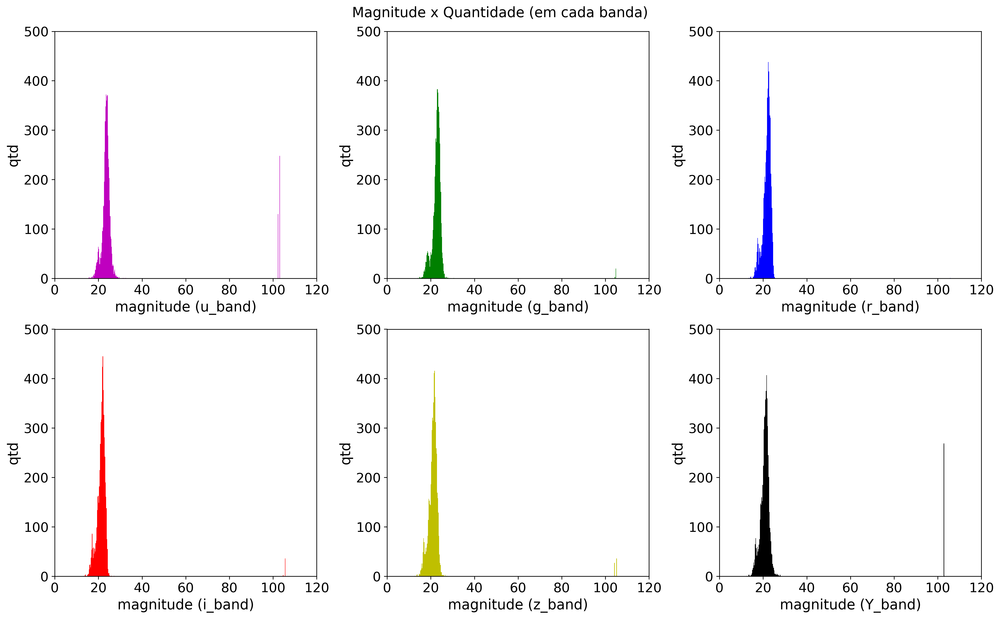

In [166]:
plt.figure(figsize=[16,10], dpi=300)
plt.suptitle("Magnitude x Quantidade (em cada banda)", fontsize=16)

pos_grafico = 1

for key, value in banda_cor.items():
    monta_grafico_hist(pos_grafico, key, value)
    pos_grafico = pos_grafico + 1

Olhando mais de perto os montinhos pode-se perceber que a maior parte da amostra fica entre 15 - 25 de magnitude

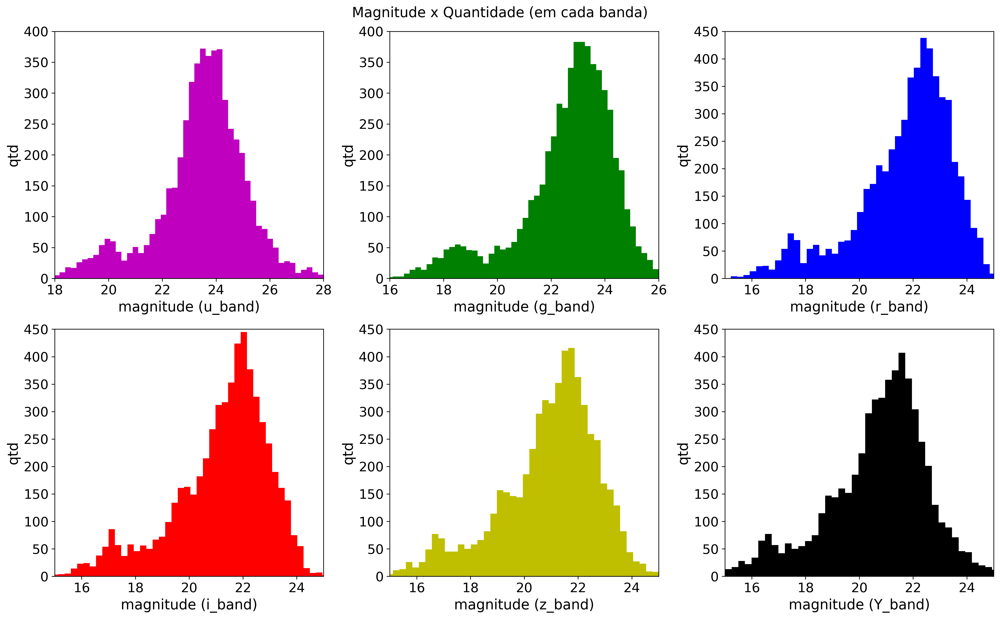

In [353]:
plt.figure(figsize=[16,10], dpi=300)
plt.suptitle("Magnitude x Quantidade (em cada banda)", fontsize=16)

monta_grafico_hist(1, "u", "m", 18, 28, y_max = 400)
monta_grafico_hist(2, "g", "g", 16, 26, y_max = 400)
monta_grafico_hist(3, "r", "b", 15, 25, y_max = 450)
monta_grafico_hist(4, "i", "r", 15, 25, y_max = 450)
monta_grafico_hist(5, "z", "y", 15, 25, y_max = 450)
monta_grafico_hist(6, "Y", "k", 15, 25, y_max = 450)

Para termos uma noção, também vale a pena olhar a quantidade de magnitudes que passaram dos valores mais comuns, passaram de 100.

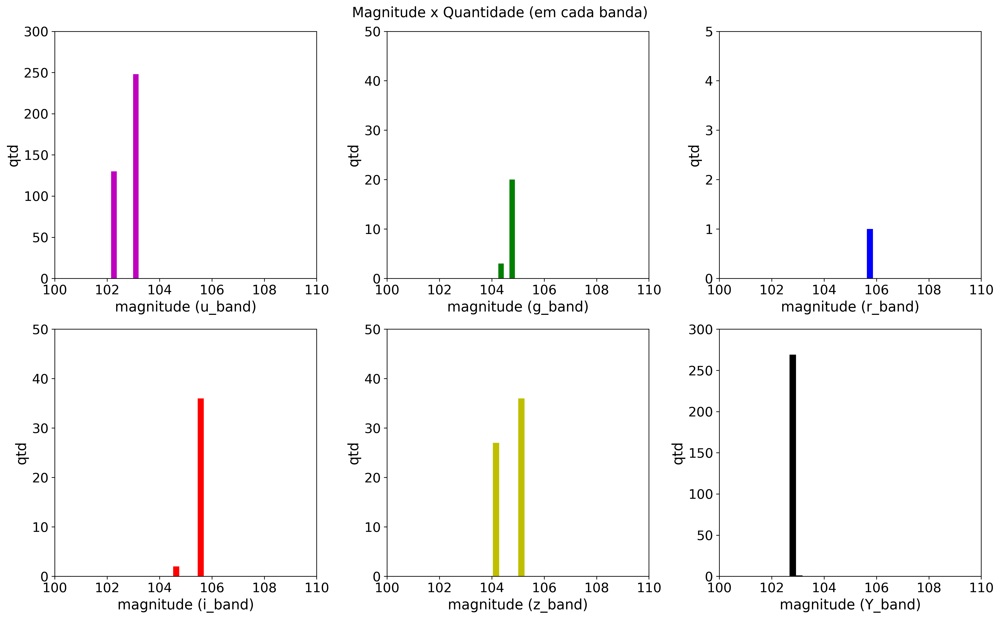

In [352]:
plt.figure(figsize=[16,10], dpi=300)
plt.suptitle("Magnitude x Quantidade (em cada banda)", fontsize=16)

monta_grafico_hist(1, "u", "m", 100, 110, y_max = 300)
monta_grafico_hist(2, "g", "g", 100, 110, y_max = 50)
monta_grafico_hist(3, "r", "b", 100, 110, y_max = 5)
monta_grafico_hist(4, "i", "r", 100, 110, y_max = 50)
monta_grafico_hist(5, "z", "y", 100, 110, y_max = 50)
monta_grafico_hist(6, "Y", "k", 100, 110, y_max = 300)

Se ignorarmos esses pontos extremos, percebemos que a maior parte da nossa amostra fica entre a magnitude 15 e 30. Aqui uma sobreposição de todas as bandas para melhor comparação.

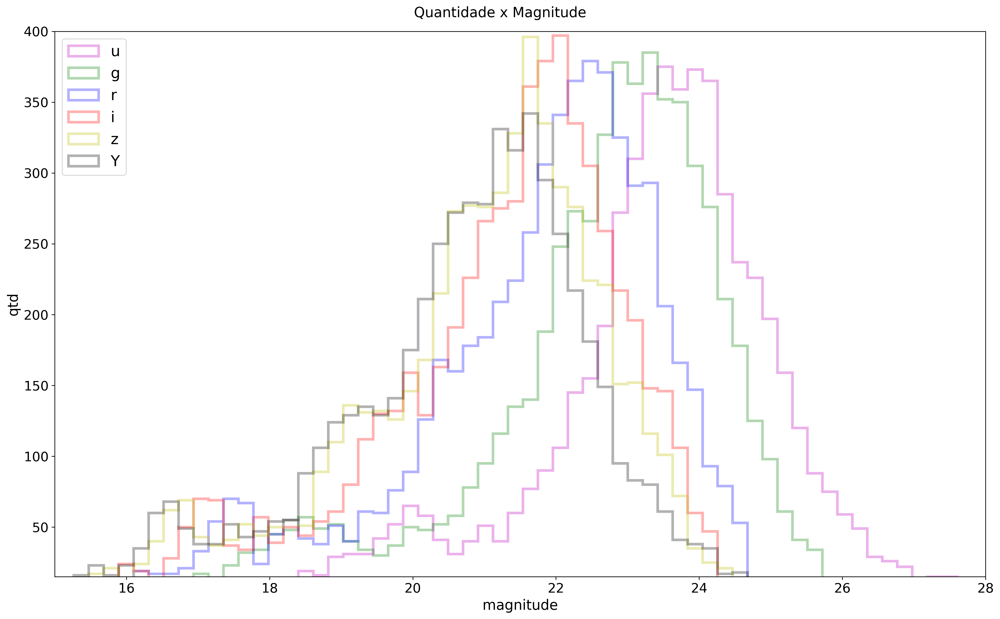

In [347]:
plt.figure(figsize=[16,10], dpi=300)
plt.suptitle("Quantidade x Magnitude", fontsize=16)


for key, value in banda_cor.items():
    plt.hist(data_frame[f"{key}_auto"], bins=np.arange(0,120, bin_width), color= value, label=key, alpha=0.3, ec=value, histtype="step", lw=3)

plt.xlabel(f"magnitude", fontsize=16)
plt.ylabel("qtd", fontsize=16)
plt.xticks(fontsize=15)
plt.yticks(fontsize=15)
plt.xlim(15, 28)
plt.ylim(15, 400)

plt.legend(loc="upper left", fontsize="xx-large", markerscale=3)
plt.tight_layout()

Também podemos olhar que a nossa maior quantidade de itens com erro ficam muito próximo de zero e conforme aumenta-se a magnitude, ou seja, quanto menor o brilho aparente que o objeto tiver, o erro na sua captura vai aumentando também.

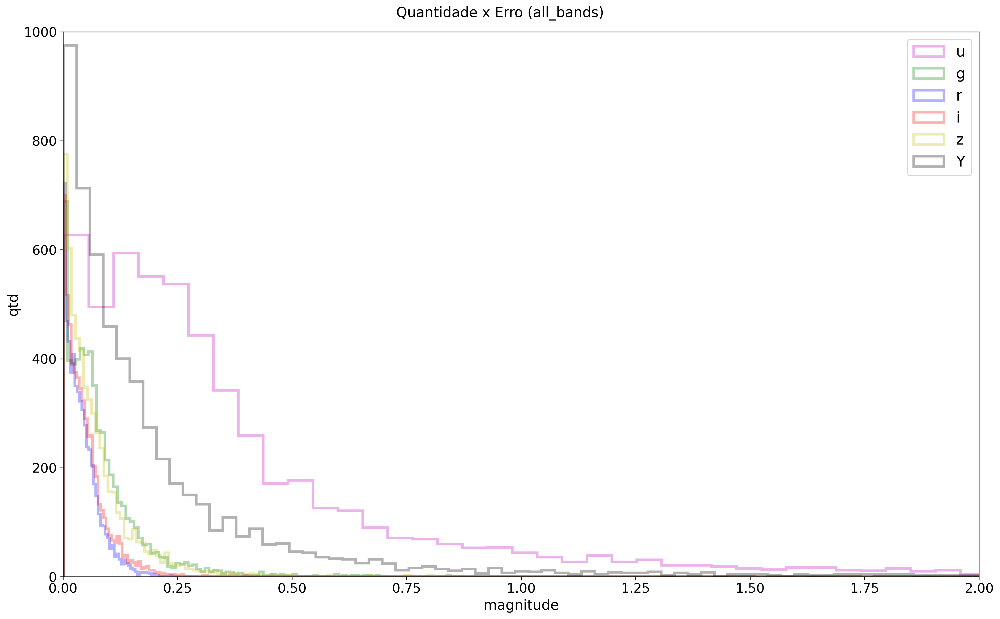

In [346]:
plt.figure(figsize=[16,10], dpi=300)
plt.suptitle("Quantidade x Erro (all_bands)", fontsize=16)

for key, value in banda_cor.items():
        plt.hist(data_frame[f"{key}_auto_err"], bins="fd", label=key, alpha=0.3, ec=value, histtype="step", lw=3)

plt.xlabel(f"magnitude", fontsize=16)
plt.ylabel("qtd", fontsize=16)
plt.xticks(fontsize=15)
plt.yticks(ticks=[500, 1500], fontsize=15)
plt.xlim(0, 2)
plt.ylim(0, 1000)
plt.yscale("linear")

plt.legend(loc="upper right", fontsize="xx-large", markerscale=3)
plt.tight_layout()

# 3 - Razão sinal ruido. 

Para cada banda a razão sinal ruido pela magnitude, indica que, dado um ponto capturado, qual a chance de ele realmente ser um objeto no céu e não somente um erro de captura, visto que erros tendem a se anular conforme o erro varia. Aqui temos um para cada banda uma comparação sinal/ruido pela magnitude

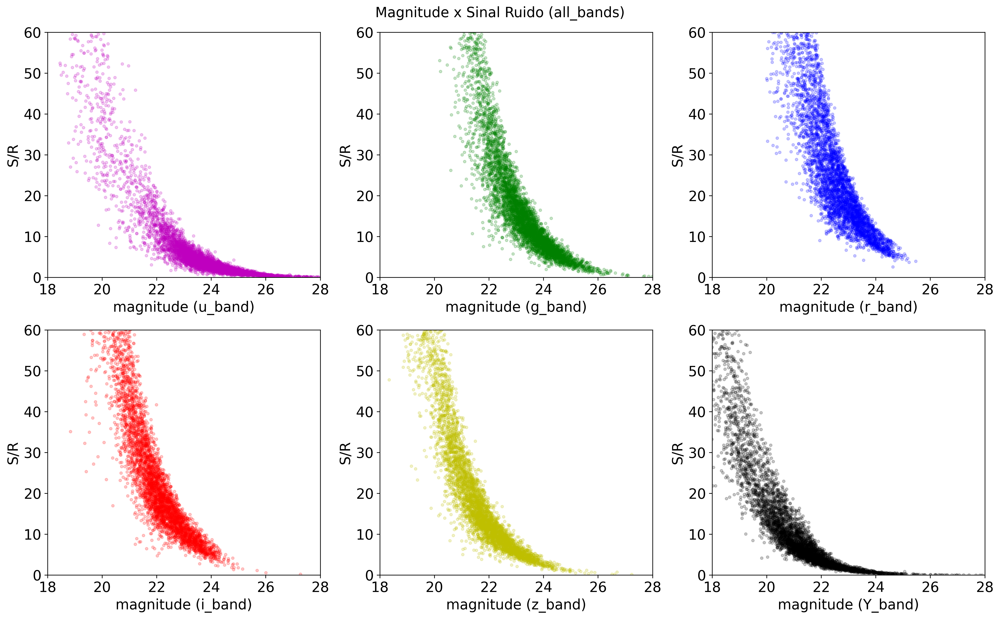

In [345]:
plt.figure(figsize=[16,10], dpi=300)
plt.suptitle("Magnitude x Sinal Ruido (all_bands)", fontsize=16)

pos_grafico = 1

for key, value in banda_cor.items():
    plt.subplot(2,3,pos_grafico)
    plt.plot(data_frame[f"{key}_auto"], 1/data_frame[f"{key}_auto_err"], f"{value}.", alpha=0.2, label=key)

    plt.xlabel(f"magnitude ({key}_band)", fontsize=16)
    plt.ylabel("S/R", fontsize=16)

    plt.xticks(fontsize=16)
    plt.yticks(fontsize=16)
    plt.xlim(18, 28)
    plt.ylim(0, 60)

    plt.tight_layout()
    
    pos_grafico = pos_grafico + 1

aqui uma comparação por todas as bandas e logo após apenas as bandas mais comuns de se utilizar, banda r e i

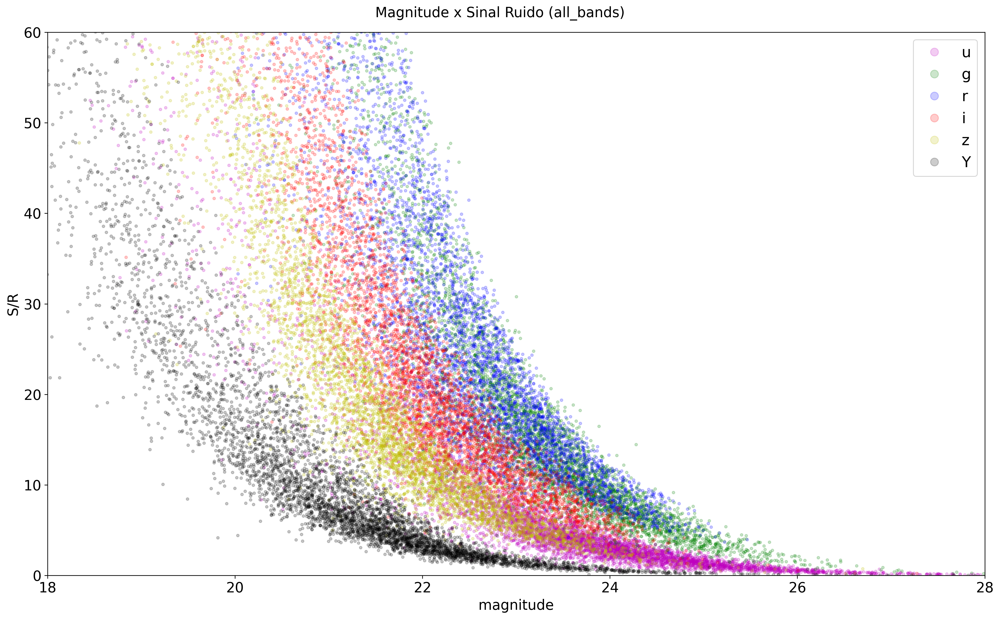

In [335]:
plt.figure(figsize=[16,10], dpi=300)
plt.suptitle("Magnitude x Sinal Ruido (all_bands)", fontsize=16)

for key, value in banda_cor.items():
    plt.plot(data_frame[f"{key}_auto"], 1/data_frame[f"{key}_auto_err"], f"{value}.", alpha=0.2, label=key)

    plt.xlabel(f"magnitude", fontsize=16)
    plt.ylabel("S/R", fontsize=16)

    plt.xticks(fontsize=16)
    plt.yticks(fontsize=16)
    plt.xlim(18, 28)
    plt.ylim(0, 60)

    plt.legend(loc="upper right", fontsize="xx-large", markerscale=3)
    plt.tight_layout()

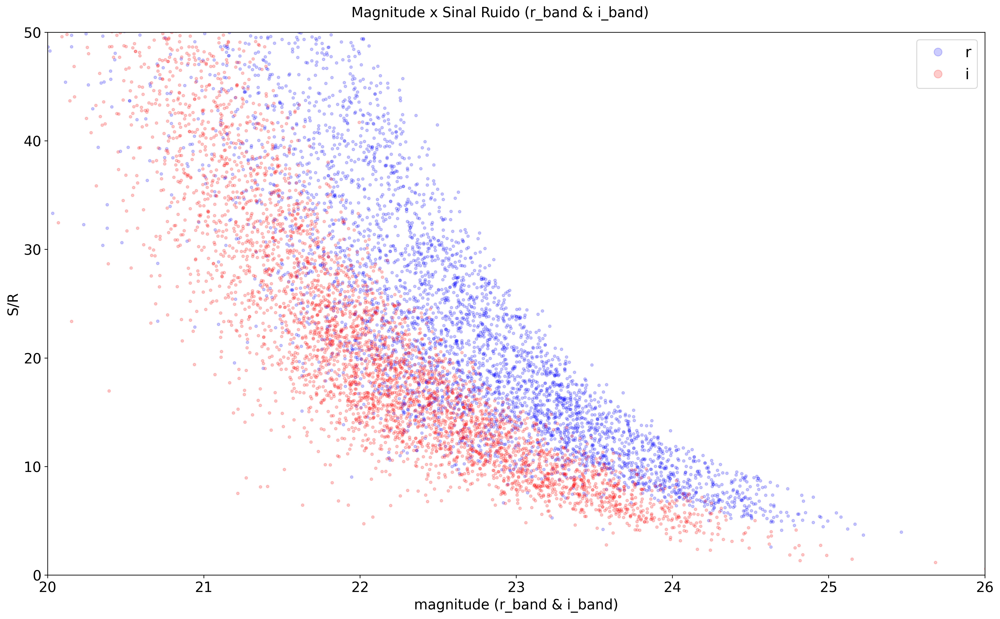

In [342]:
plt.figure(figsize=[16,10], dpi=300)
plt.suptitle("Magnitude x Sinal Ruido (r_band & i_band)", fontsize=16)

plt.plot(data_frame[f"r_auto"], 1/data_frame[f"r_auto_err"], f"b.", alpha=0.2, label="r")
plt.plot(data_frame[f"i_auto"], 1/data_frame[f"i_auto_err"], f"r.", alpha=0.2, label="i")

plt.xlabel(f"magnitude (r_band & i_band)", fontsize=16)
plt.ylabel("S/R", fontsize=16)

plt.xticks(fontsize=16)
plt.yticks(fontsize=16)
plt.xlim(20, 26)
plt.ylim(0, 50)

plt.legend(loc="upper right", fontsize="xx-large", markerscale=3)
plt.tight_layout()

# 5 - Localização da amostra no céu

Primeiro, importamos a lib Healpy que ajudará na visualização do céu e olharemos as colunas que estão dispostas para montar as coordenadas

In [80]:
import healpy as hp

Como nos foi disponibilizado as colunas de ascendência de reta e declinação, podemos fazer uma associação (x,y) e localizar onde, no céu foi coletado esses dados.

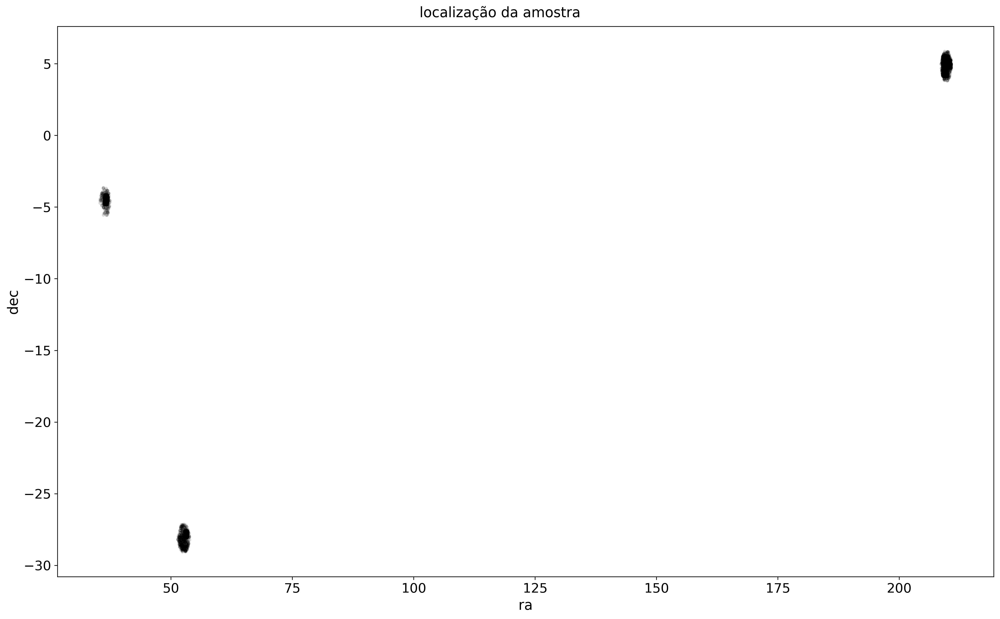

In [295]:
plt.figure(figsize=[16,10], dpi=300)
plt.suptitle("localização da amostra", fontsize=16)

plt.plot(data_frame.ra, data_frame.dec, f"{value}.", alpha=0.1)
plt.xlabel("ra", fontsize=16)
plt.ylabel("dec", fontsize=16)
plt.xticks(fontsize=15)
plt.yticks(fontsize=15)

plt.tight_layout()

Para cada ponto, foi aproximado a visão, e conforme a quantidade aglomerada, podemos perceber onde aconteceu a maior parte de captura, juntamente com a sua limitação formada pelo desenho de grade que aparece 

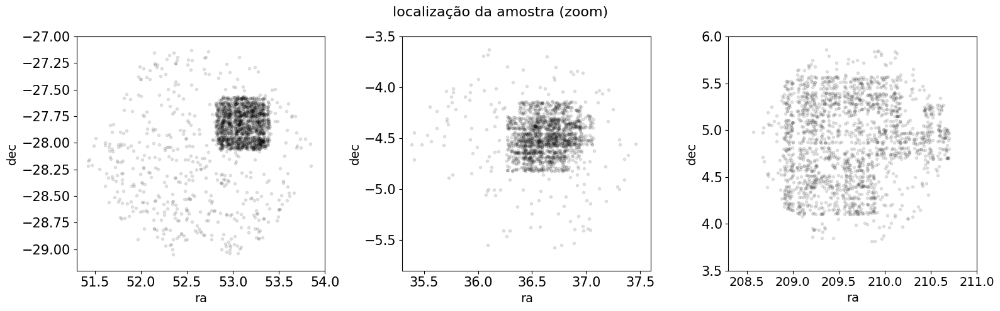

In [293]:
plt.figure(figsize=[16,5], dpi=100)
plt.suptitle("localização da amostra (zoom)", fontsize=16)

plt.subplot(1,3,1)
plt.plot(data_frame.ra, data_frame.dec, f"{value}.", alpha=0.1)

plt.xlabel("ra", fontsize=14)
plt.ylabel("dec", fontsize=14)
plt.xticks(fontsize=15)
plt.yticks(fontsize=15)
plt.xlim(51.3, 54)
plt.ylim(-29.2, -27)

plt.subplot(1,3,2)
plt.plot(data_frame.ra, data_frame.dec, f"{value}.", alpha=0.1)

plt.xlabel("ra", fontsize=14)
plt.ylabel("dec", fontsize=14)
plt.xticks(fontsize=15)
plt.yticks(fontsize=15)
plt.xlim(35.3, 37.6)
plt.ylim(-5.8, -3.5)

plt.subplot(1,3,3)
plt.plot(data_frame.ra, data_frame.dec, f"{value}.", alpha=0.1)

plt.xlabel("ra", fontsize=14)
plt.ylabel("dec", fontsize=14)
plt.xticks(fontsize=14)
plt.yticks(fontsize=15)
plt.xlim(208.3, 211)
plt.ylim(3.5, 6)

plt.tight_layout()

Existem melhores formas de fazer uma query, mas a ideia aqui é ter uma noção, então, foi selecionado para cada "bolinho" capturado, a média da ascenção de reta (ra) e declinação (dec)

In [54]:
medias_1 = data_frame.query("ra > 50 & ra < 75 & dec < -25").mean()
print(medias_1.ra, medias_1.dec)
medias_2 = data_frame.query("ra < 50 & dec < 0 & dec > -10").mean()
print(medias_2.ra, medias_2.dec)
medias_3 = data_frame.query("ra > 50 & dec > 0").mean()
print(medias_3.ra, medias_3.dec)

52.982684136485226 -27.914789136415074
36.615372028534296 -4.496395828915506
209.6269803400604 4.885842334037079


logo após foi, para cada média dos bolinhos criado vetores de localização para depois conseguir mostrar no mapa.

In [57]:
NSIDE = 32
NPIX = hp.nside2npix(NSIDE)

vec1 = hp.ang2vec(round(medias_1.ra, 2), round(medias_1.dec,2), True)
vec2 = hp.ang2vec(round(medias_2.ra, 2), round(medias_2.dec,2), True)
vec3 = hp.ang2vec(round(medias_3.ra, 2), round(medias_3.dec,2), True)

print(vec1, vec2, vec3)

[ 0.53206059  0.7055557  -0.46808405] [ 0.80013513  0.59466625 -0.0784591 ] [-0.86607233 -0.49259755  0.08524303]


para cada vetor criado, foi selecionado todos os pontos com distancia de 1 radianos para mostrar no mapa, marcando assim a localização no céu

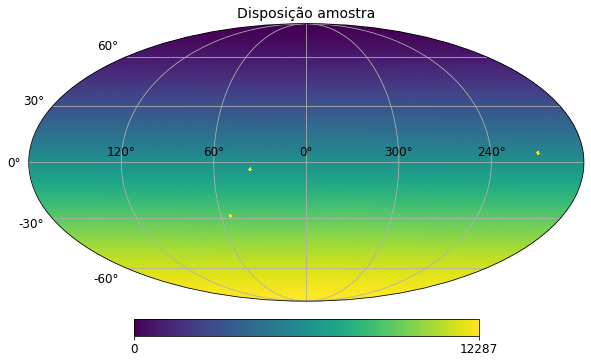

In [81]:
ipix_disc1 = hp.query_disc(nside=32, vec=vec1, radius=np.radians(1))
ipix_disc2 = hp.query_disc(nside=32, vec=vec2, radius=np.radians(1))
ipix_disc3 = hp.query_disc(nside=32, vec=vec3, radius=np.radians(1))

m = np.arange(NPIX)
m[ipix_disc1] = m.max()
m[ipix_disc2] = m.max()
m[ipix_disc3] = m.max()

hp.projview(m, title="Disposição amostra", graticule=True, graticule_labels=True, projection_type="mollweide")